In [211]:
import numpy as np
import pandas as pd
import NaiveDE
import SpatialDE
import tracemalloc
import glob
import re
import time
import resource
import random
import os
import matplotlib.pyplot as plt
import anndata as ad
import scanpy as sc
import seaborn as sns

In [9]:
!pip install anndata scanpy

  Obtaining dependency information for anndata from https://files.pythonhosted.org/packages/0a/4b/ab615fea52e34579d5c6c7dba86b4f9d7f3cdb6a170b348ec49f34cf4355/anndata-0.11.4-py3-none-any.whl.metadata
  Obtaining dependency information for scanpy from https://files.pythonhosted.org/packages/3c/ef/48779cf7cb7aa06be0cdb27ee3ae62d5efae0edffc15861f655be822ee98/scanpy-1.11.1-py3-none-any.whl.metadata
  Obtaining dependency information for array-api-compat!=1.5,>1.4 from https://files.pythonhosted.org/packages/e0/b1/0542e0cab6f49f151a2d7a42400f84f706fc0b64e85dc1f56708b2e9fd37/array_api_compat-1.12.0-py3-none-any.whl.metadata
  Obtaining dependency information for natsort from https://files.pythonhosted.org/packages/ef/82/7a9d0550484a62c6da82858ee9419f3dd1ccc9aa1c26a1e43da3ecd20b0d/natsort-8.4.0-py3-none-any.whl.metadata
  Obtaining dependency information for packaging>=24.2 from https://files.pythonhosted.org/packages/20/12/38679034af332785aac8774540895e234f4d07f7545804097de4b666afd8/packagin

In [5]:
!pip install NaiveDE
!pip install SpatialDE

  Preparing metadata (setup.py) ... done
doneel for NaiveDE (setup.py) ... 
  Created wheel for NaiveDE: filename=NaiveDE-1.2.0-py3-none-any.whl size=5687 sha256=e8205a44bf493dff2844da2735eb76cbd87547113b817fe04debc5e39a283cbb
  Stored in directory: /Users/dongli/Library/Caches/pip/wheels/5a/d9/6a/5d31ca0ef9362888a38bb5d2b7c6f15a1e5aacdfe1bc669afc
Successfully built NaiveDE
  Obtaining dependency information for SpatialDE from https://files.pythonhosted.org/packages/a7/5a/ff529dc90a6adfd23f27fa302b50c703bf898d66059bf56b2e31c55ce762/SpatialDE-1.1.3-py3-none-any.whl.metadata


# Data processing

In [ ]:
omics280 = pd.read_csv("../benchmark_datasets/sim_omics_niche2_state8_seed0.csv")
meta280  = pd.read_csv("../benchmark_datasets/sim_meta_niche2_state8_seed0.csv")

In [ ]:
omics281 = pd.read_csv("../benchmark_datasets/sim_omics_niche2_state8_seed1.csv")
meta281  = pd.read_csv("../benchmark_datasets/sim_meta_niche2_state8_seed1.csv")

In [ ]:
omics290 = pd.read_csv("../benchmark_datasets/sim_omics_niche2_state9_seed0.csv")
meta290  = pd.read_csv("../benchmark_datasets/sim_meta_niche2_state9_seed0.csv")

In [ ]:
omics291 = pd.read_csv("../benchmark_datasets/sim_omics_niche2_state9_seed1.csv")
meta291  = pd.read_csv("../benchmark_datasets/sim_meta_niche2_state9_seed1.csv")

In [ ]:
omics380 = pd.read_csv("../benchmark_datasets/sim_omics_niche3_state8_seed0.csv")
meta380  = pd.read_csv("../benchmark_datasets/sim_meta_niche3_state8_seed0.csv")

In [ ]:
omics381 = pd.read_csv("../benchmark_datasets/sim_omics_niche3_state8_seed1.csv")
meta381  = pd.read_csv("../benchmark_datasets/sim_meta_niche3_state8_seed1.csv")

In [ ]:
omics390 = pd.read_csv("../benchmark_datasets/sim_omics_niche3_state9_seed0.csv")
meta390  = pd.read_csv("../benchmark_datasets/sim_meta_niche3_state9_seed0.csv")

In [ ]:
omics391 = pd.read_csv("../benchmark_datasets/sim_omics_niche3_state9_seed1.csv")
meta391  = pd.read_csv("../benchmark_datasets/sim_meta_niche3_state9_seed1.csv")

# Sim280

In [17]:
adata280 = ad.AnnData(omics280)
adata280.obs = meta280

/Users/dongli/anaconda3/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [19]:
adata280.X

array([[ 4,  6,  4, ...,  0,  5,  0],
       [ 1,  2,  2, ...,  0,  0,  0],
       [11,  2,  1, ...,  0,  1,  3],
       ...,
       [ 0,  1,  1, ...,  0,  0,  1],
       [ 7,  3,  4, ...,  0,  0,  2],
       [ 5,  4,  4, ...,  0,  0,  0]])

In [21]:
cmat280 = pd.DataFrame(adata280.X, index=adata280.obs_names)
cmat280 = cmat280.transpose()

In [23]:
cmat280

,0,1,2,3,4,5,6,7,8,9,...,3161,3162,3163,3164,3165,3166,3167,3168,3169,3170
0,4,1,11,1,7,3,0,4,2,2,...,3,0,0,3,3,0,2,0,7,5
1,6,2,2,0,1,0,2,0,3,0,...,0,0,1,2,0,11,0,1,3,4
2,4,2,1,1,1,4,0,3,1,0,...,1,5,2,4,4,1,0,1,4,4
3,5,1,3,2,2,1,3,2,0,3,...,1,3,0,3,1,2,1,0,2,0
4,1,1,0,0,0,0,1,0,0,1,...,0,0,0,0,2,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
215,1,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
216,1,3,2,1,0,1,0,2,0,0,...,0,0,0,0,1,0,0,0,1,1
217,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
218,5,0,1,0,0,0,0,0,0,0,...,0,3,1,1,3,1,0,0,0,0


In [25]:
adata280.obsm["spatial"] = adata280.obs[["col", "row"]].to_numpy()

In [29]:
spatial_loc280 = pd.DataFrame(adata280.obsm['spatial'], columns=['x', 'y'], index=adata280.obs_names)
spatial_loc280 = spatial_loc280.loc[cmat280.columns,]
spatial_loc280['total_counts'] = cmat280.sum(axis=0)

In [31]:
spatial_loc280[['x', 'y']] = spatial_loc280[['x', 'y']].apply(pd.to_numeric, errors='coerce')
spatial_loc280['total_counts'] = pd.to_numeric(spatial_loc280['total_counts'], errors='coerce')
spatial_loc280['log_total_counts'] = np.log(spatial_loc280['total_counts'])

In [33]:
spatial_loc280['log_total_counts'] = pd.to_numeric(spatial_loc280['log_total_counts'], errors='coerce')

In [37]:
norm_expr = NaiveDE.stabilize(cmat280.T)
resid_expr = NaiveDE.regress_out(spatial_loc280, norm_expr.T, 'log_total_counts').T

In [39]:
norm_expr

,0,1,2,3,4,5,6,7,8,9,...,210,211,212,213,214,215,216,217,218,219
0,1.407607,1.806018,1.407607,1.626524,0.082652,-2.451505,-2.451505,-2.451505,-2.451505,0.082652,...,0.082652,-2.451505,-2.451505,0.082652,1.126929,0.082652,0.082652,-2.451505,1.626524,-2.451505
1,0.082652,0.735327,0.735327,0.082652,0.082652,-2.451505,-2.451505,-2.451505,0.082652,0.082652,...,-2.451505,-2.451505,-2.451505,-2.451505,0.082652,-2.451505,1.126929,-2.451505,-2.451505,-2.451505
2,2.405698,0.735327,0.082652,1.126929,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,...,-2.451505,-2.451505,-2.451505,1.126929,1.407607,0.082652,0.735327,-2.451505,0.082652,1.126929
3,0.082652,-2.451505,0.082652,0.735327,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,...,0.735327,-2.451505,-2.451505,0.082652,0.082652,-2.451505,0.082652,-2.451505,-2.451505,-2.451505
4,1.958144,0.082652,0.082652,0.735327,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,...,-2.451505,-2.451505,-2.451505,0.735327,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,0.082652
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3166,-2.451505,2.405698,0.082652,0.735327,-2.451505,-2.451505,0.082652,0.082652,-2.451505,-2.451505,...,-2.451505,0.082652,-2.451505,-2.451505,0.735327,-2.451505,-2.451505,-2.451505,0.082652,0.082652
3167,0.735327,-2.451505,-2.451505,0.082652,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,...,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,0.082652,-2.451505,-2.451505
3168,-2.451505,0.082652,0.082652,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,...,-2.451505,-2.451505,-2.451505,0.735327,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,0.082652
3169,1.958144,1.126929,1.407607,0.735327,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,-2.451505,...,-2.451505,-2.451505,-2.451505,0.735327,-2.451505,0.082652,0.082652,-2.451505,-2.451505,0.735327


In [41]:
resid_expr

,0,1,2,3,4,5,6,7,8,9,...,210,211,212,213,214,215,216,217,218,219
0,-9.687217,-2.409410,-5.727896,-6.567344,1.285676,-2.572906,-2.509774,-2.443474,-5.385068,-0.009649,...,-4.757867,-3.443000,-2.399509,-7.423163,-5.680858,-0.046094,-5.189135,-1.589630,2.464245,-9.887720
1,-10.583692,-3.317302,-6.124604,-7.794770,1.239216,-2.568218,-2.507524,-2.443784,-2.737617,-0.006084,...,-7.105085,-3.404709,-2.401517,-9.667448,-6.462220,-2.575279,-3.941263,-1.622916,-1.646136,-9.600536
2,-8.818089,-3.529100,-7.135792,-7.162182,-1.234497,-2.574317,-2.510452,-2.443380,-5.419167,-2.544879,...,-7.348289,-3.454525,-2.398905,-6.466132,-5.479312,-0.047591,-4.597738,-1.579612,0.930111,-6.395724
3,-10.685400,-6.542777,-6.842692,-7.217210,-1.283913,-2.569331,-2.508058,-2.443710,-5.298667,-2.541087,...,-3.962627,-3.413798,-2.401040,-7.202098,-6.524628,-2.576459,-5.033867,-1.615015,-1.638457,-9.668705
4,-9.068762,-4.106971,-7.009170,-7.408382,-1.255845,-2.572163,-2.509418,-2.443523,-5.367110,-2.543241,...,-7.262393,-3.436931,-2.399827,-6.724541,-9.217618,-2.579463,-7.691021,-1.594906,-1.618912,-7.308042
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3166,-11.874951,-1.174698,-5.977924,-6.224177,-1.429710,-2.554618,0.033161,0.089474,-4.943142,-2.529901,...,-6.562825,-0.759480,-2.407342,-8.826608,-5.046902,-2.560856,-6.929125,-1.719467,0.794175,-6.233336
3167,-5.794359,-4.932429,-6.650994,-4.739721,-1.743484,-2.522954,-2.485798,-2.446778,-4.178008,-2.505827,...,-5.300317,-3.035034,-2.420904,-6.868936,-6.458122,-2.527277,-5.554133,0.589895,-1.958477,-6.827974
3168,-12.101888,-3.583967,-6.123876,-9.578609,-1.405103,-2.557101,-2.502188,-2.444519,-5.003146,-2.531789,...,-6.661835,-3.313917,-2.406278,-5.793303,-8.372983,-2.563490,-7.036955,-1.701838,-1.722847,-6.385439
3169,-9.376637,-3.179670,-5.882222,-7.635757,-1.222462,-2.575532,-2.511035,-2.443300,-5.448514,-2.545802,...,-7.396714,-3.464444,-2.398385,-6.932823,-9.406530,-0.048879,-5.303153,-1.570990,-1.595665,-6.861718


In [43]:
result = SpatialDE.run(spatial_loc280[['x', 'y']].values, resid_expr)

Models:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:310: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  model_results = model_results[model_results.groupby(['g'])['max_ll'].transform(max) == model_results['max_ll']]


In [46]:
result.describe()

,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,n,s2_FSV,s2_logdelta,time,BIC,max_ll_null,LLR,pval,qval
count,2.200000e+02,220.0,220.000000,220.000000,2.200000e+02,220.000000,220.000000,2.200000e+02,220.0,2.200000e+02,2.200000e+02,220.000000,220.000000,220.000000,220.000000,220.000000,220.000000
mean,3.044375e-01,4.0,109.500000,15.485960,7.281599e+07,-4657.116485,-3.900706,6.109456e+00,3171.0,3.421010e+02,3.818865e+19,0.004532,9346.480180,-4658.678162,1.561677,0.512162,0.775876
std,4.132556e-01,0.0,63.652704,18.125360,1.666481e+08,975.333725,2.787918,1.438608e+01,0.0,3.364264e+03,5.660104e+20,0.003313,1950.667450,975.448873,2.496314,0.365842,0.282303
min,2.001322e-09,4.0,0.000000,0.109162,4.539993e-05,-6779.202078,-10.323540,2.008102e-09,3171.0,5.634827e-07,2.111592e-02,0.001692,4707.885251,-6784.715995,0.000079,0.000286,0.028500
25%,1.297456e-03,4.0,54.750000,0.272940,7.991848e-01,-5467.913941,-6.117111,5.612397e-03,3171.0,2.222470e-05,6.444524e-01,0.002147,7827.016875,-5469.181169,0.024880,0.156260,0.587499
50%,8.104621e-03,4.0,109.500000,4.266365,9.673693e+01,-4929.142732,-2.637019,9.090026e-02,3171.0,1.175080e-04,1.618302e+01,0.002436,9890.532674,-4929.609086,0.426527,0.513700,0.992915
75%,5.559593e-01,4.0,164.250000,26.671751,4.893984e+02,-3897.384833,-1.951420,5.214957e+00,3171.0,9.262106e-01,1.043250e+11,0.007530,10968.075091,-3898.653039,2.010325,0.874680,0.992915
max,9.999546e-01,4.0,219.000000,66.688092,4.851652e+08,-2337.819021,1.447955,1.088301e+02,3171.0,4.924818e+04,8.395318e+21,0.017062,13590.651366,-2343.743001,13.162784,0.992915,0.992915


In [48]:
result.head().T

,0,1,2,3,4
FSV,0.999955,0.999955,0.999955,0.999955,0.999955
M,4,4,4,4,4
g,0,4,6,9,19
l,0.109162,0.109162,0.109162,0.109162,0.109162
max_delta,0.000045,0.000045,0.000045,0.000045,0.000045
max_ll,-5806.777626,-3866.241904,-2961.349321,-3077.914034,-4156.715403
max_mu_hat,-10.32354,-1.059118,-2.353256,-2.37733,-2.216789
max_s2_t_hat,108.830126,1.792172,5.915486,6.058258,5.71852
model,SE,SE,SE,SE,SE
n,3171,3171,3171,3171,3171


In [50]:
result.sort_values('qval').head(15)[['g', 'l', 'qval']]

,g,l,qval
134,51,26.671751,0.028500
161,112,26.671751,0.028500
172,131,26.671751,0.028500
219,204,66.688092,0.044463
132,49,26.671751,0.044463
155,100,26.671751,0.044463
129,45,26.671751,0.067897
203,215,26.671751,0.087530
93,165,0.682440,0.115760
125,23,26.671751,0.115760


In [52]:
top15_genes = result.sort_values("qval").head(15)["g"].tolist()

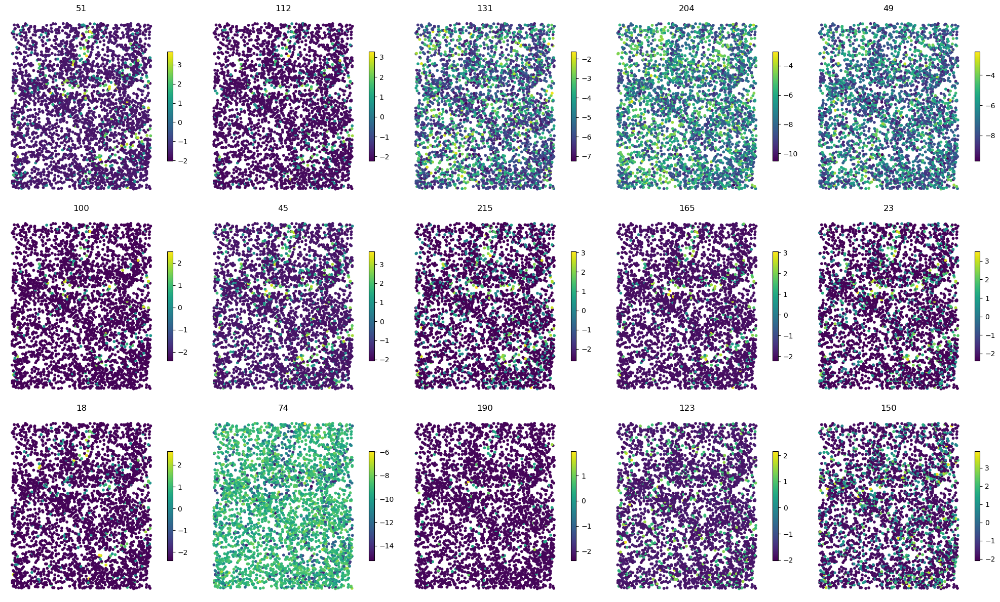

In [56]:
n_cols = 5
n_rows = (len(top15_genes) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows))
axes = axes.flatten()

resid_t = pd.DataFrame(resid_expr, index=cmat280.columns, columns=cmat280.index).T
for i, gene in enumerate(top15_genes):
    ax = axes[i]

    # extract spatial expression
    df = spatial_loc280.copy()
    df["expression"] = resid_t.loc[gene].values

    sc = ax.scatter(df["x"], df["y"], c=df["expression"], cmap="viridis", s=10)
    ax.set_title(gene)
    ax.axis("off")
    fig.colorbar(sc, ax=ax, shrink=0.6)

# remove empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## The fraction of variance explained by spatial variation

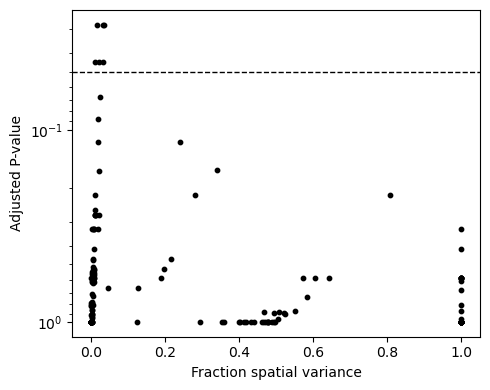

In [58]:
#plot
plt.figure(figsize=(5, 4))
plt.yscale('log')

# Scatter plot of FSV vs q-value
plt.scatter(result['FSV'], result['qval'], color='black', s=10)

# add significance threshold line at q = 0.05
plt.axhline(0.05, color='black', linewidth=1, linestyle='--')

plt.gca().invert_yaxis()
plt.xlabel('Fraction spatial variance')
plt.ylabel('Adjusted P-value')

plt.tight_layout()
plt.show()

## **Automatic expression histology**

In [80]:
sign_results = result.query('qval < 0.05')
sign_results['l'].value_counts()

l
26.671751    5
66.688092    1
Name: count, dtype: int64

In [84]:
spatial_loc_sampled = spatial_loc280.sample(n=1000, random_state=42)

resid_expr_sampled = resid_expr.loc[spatial_loc_sampled.index].copy()

In [86]:
histology_results, patterns = SpatialDE.aeh.spatial_patterns(spatial_loc_sampled[['x', 'y']].values, resid_expr_sampled, sign_results, C=5, l=8.7, verbosity=2)

iter 0, ELBO: -5.76e+10

iter 1, ELBO: -2.79e+10, delta_ELBO: 2.97e+10
ln(l): 2.16, ln(s2e): 0.69

iter 2, ELBO: -2.79e+10, delta_ELBO: 1.00e+03
ln(l): 2.16, ln(s2e): -0.16

iter 3, ELBO: -2.79e+10, delta_ELBO: 3.40e+02
ln(l): 2.16, ln(s2e): -0.25

iter 4, ELBO: -2.79e+10, delta_ELBO: 1.84e+01
ln(l): 2.16, ln(s2e): -0.26

iter 5, ELBO: -2.79e+10, delta_ELBO: 9.71e-01
ln(l): 2.16, ln(s2e): -0.26

iter 6, ELBO: -2.79e+10, delta_ELBO: 4.86e-02
ln(l): 2.16, ln(s2e): -0.26

iter 7, ELBO: -2.79e+10, delta_ELBO: 2.37e-03
ln(l): 2.16, ln(s2e): -0.26

Converged on iter 7


In [90]:
print(spatial_loc_sampled.columns)

Index(['x', 'y', 'total_counts', 'log_total_counts'], dtype='object')


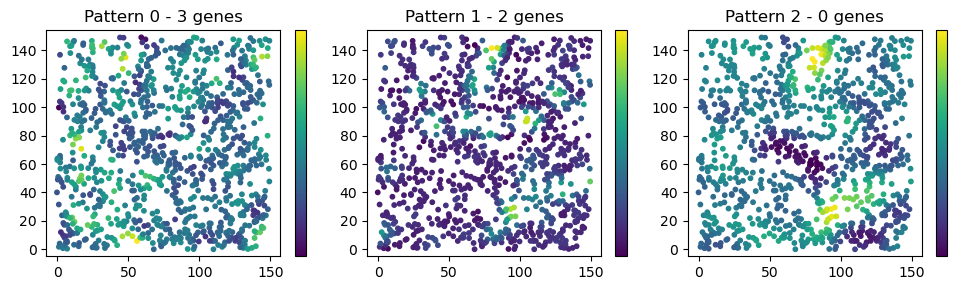

In [92]:
plt.figure(figsize=(10, 3))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.scatter(spatial_loc_sampled['x'], spatial_loc_sampled['y'], c=patterns.iloc[:, i], cmap='viridis', s=10)
    plt.axis('equal')

    n_genes = histology_results.query('pattern == @i').shape[0]
    plt.title(f'Pattern {i} - {n_genes} genes')
    plt.colorbar(ticks=[])

plt.tight_layout()
plt.show()

# Sim281

In [100]:
adata281 = ad.AnnData(omics281)
adata281.obs = meta281

/Users/dongli/anaconda3/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [102]:
cmat281 = pd.DataFrame(adata281.X, index=adata281.obs_names)
cmat281 = cmat281.transpose()

In [104]:
adata281.obsm["spatial"] = adata281.obs[["col", "row"]].to_numpy()

spatial_loc281 = pd.DataFrame(adata281.obsm['spatial'], columns=['x', 'y'], index=adata281.obs_names)
spatial_loc281 = spatial_loc281.loc[cmat281.columns,]
spatial_loc281['total_counts'] = cmat281.sum(axis=0)

spatial_loc281[['x', 'y']] = spatial_loc281[['x', 'y']].apply(pd.to_numeric, errors='coerce')
spatial_loc281['total_counts'] = pd.to_numeric(spatial_loc281['total_counts'], errors='coerce')
spatial_loc281['log_total_counts'] = np.log(spatial_loc281['total_counts'])

spatial_loc281['log_total_counts'] = pd.to_numeric(spatial_loc281['log_total_counts'], errors='coerce')

In [106]:
norm_expr = NaiveDE.stabilize(cmat281.T)
resid_expr = NaiveDE.regress_out(spatial_loc281, norm_expr.T, 'log_total_counts').T

In [108]:
result = SpatialDE.run(spatial_loc281[['x', 'y']].values, resid_expr)

Models:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:310: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  model_results = model_results[model_results.groupby(['g'])['max_ll'].transform(max) == model_results['max_ll']]


In [110]:
result.sort_values('qval').head(15)[['g', 'l', 'qval']]

,g,l,qval
93,44,11.253410,0.000000e+00
97,74,11.253410,0.000000e+00
85,156,4.560643,0.000000e+00
84,150,4.560643,0.000000e+00
103,132,11.253410,0.000000e+00
83,149,4.560643,0.000000e+00
88,204,4.560643,0.000000e+00
81,125,4.560643,0.000000e+00
80,83,4.560643,0.000000e+00
78,55,4.560643,0.000000e+00


In [112]:
top15_genes = result.sort_values("qval").head(15)["g"].tolist()

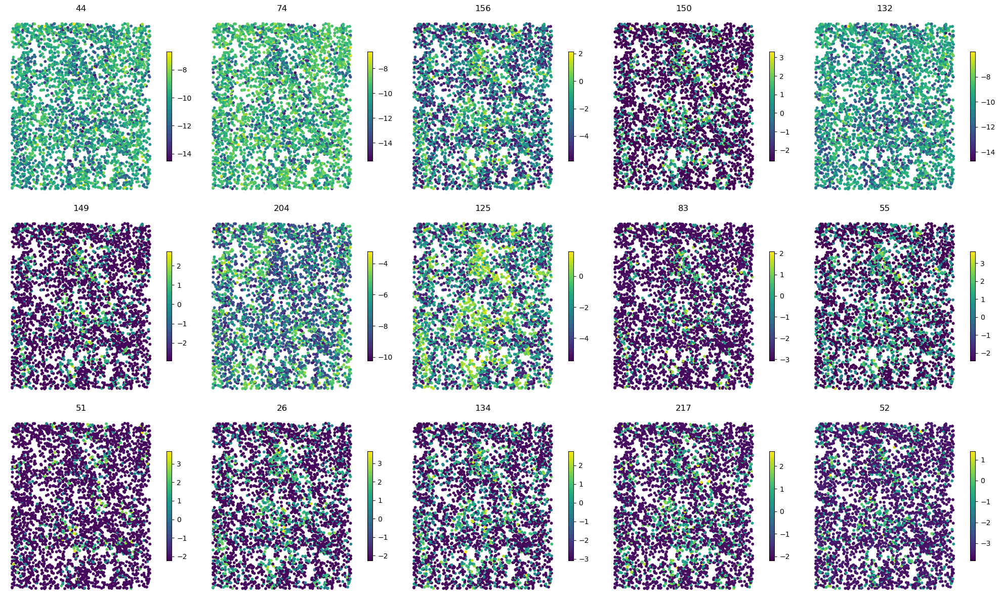

In [114]:
n_cols = 5
n_rows = (len(top15_genes) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows))
axes = axes.flatten()

resid_t = pd.DataFrame(resid_expr, index=cmat281.columns, columns=cmat281.index).T
for i, gene in enumerate(top15_genes):
    ax = axes[i]

    # extract spatial expression
    df = spatial_loc281.copy()
    df["expression"] = resid_t.loc[gene].values

    sc = ax.scatter(df["x"], df["y"], c=df["expression"], cmap="viridis", s=10)
    ax.set_title(gene)
    ax.axis("off")
    fig.colorbar(sc, ax=ax, shrink=0.6)

# remove empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### The fraction of variance explained by spatial variation

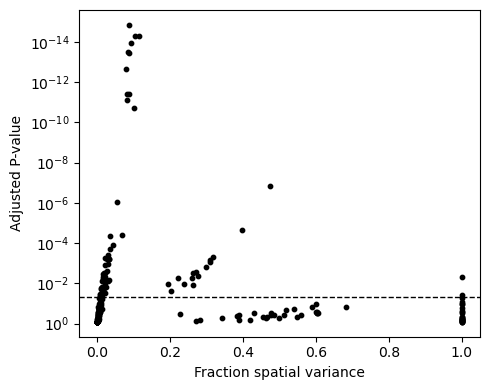

In [119]:
#plot
plt.figure(figsize=(5, 4))
plt.yscale('log')

# Scatter plot of FSV vs q-value
plt.scatter(result['FSV'], result['qval'], color='black', s=10)

# add significance threshold line at q = 0.05
plt.axhline(0.05, color='black', linewidth=1, linestyle='--')

plt.gca().invert_yaxis()
plt.xlabel('Fraction spatial variance')
plt.ylabel('Adjusted P-value')

plt.tight_layout()
plt.show()

## **Automatic expression histology**

In [123]:
sign_results = result.query('qval < 0.05')
sign_results['l'].value_counts()

l
27.767848    38
0.749048     15
11.253410    14
4.560643     10
0.303565      2
Name: count, dtype: int64

In [125]:
spatial_loc_sampled = spatial_loc281.sample(n=1000, random_state=42)

resid_expr_sampled = resid_expr.loc[spatial_loc_sampled.index].copy()

In [127]:
histology_results, patterns = SpatialDE.aeh.spatial_patterns(spatial_loc_sampled[['x', 'y']].values, resid_expr_sampled, sign_results, C=5, l=8.7, verbosity=2)

iter 0, ELBO: -4.77e+10

iter 1, ELBO: -2.42e+10, delta_ELBO: 2.35e+10
ln(l): 2.16, ln(s2e): 0.69

iter 2, ELBO: -2.42e+10, delta_ELBO: 1.10e+04
ln(l): 2.16, ln(s2e): -0.08

iter 3, ELBO: -2.42e+10, delta_ELBO: 3.47e+03
ln(l): 2.16, ln(s2e): -0.17

iter 4, ELBO: -2.42e+10, delta_ELBO: 4.47e+02
ln(l): 2.16, ln(s2e): -0.18

iter 5, ELBO: -2.42e+10, delta_ELBO: 1.48e+02
ln(l): 2.16, ln(s2e): -0.19

iter 6, ELBO: -2.42e+10, delta_ELBO: 5.30e+00
ln(l): 2.16, ln(s2e): -0.19

iter 7, ELBO: -2.42e+10, delta_ELBO: 1.42e+01
ln(l): 2.16, ln(s2e): -0.19

iter 8, ELBO: -2.42e+10, delta_ELBO: 7.57e+00
ln(l): 2.16, ln(s2e): -0.19

iter 9, ELBO: -2.42e+10, delta_ELBO: 8.38e+00
ln(l): 2.16, ln(s2e): -0.19

iter 10, ELBO: -2.42e+10, delta_ELBO: 1.57e-01
ln(l): 2.16, ln(s2e): -0.19

iter 11, ELBO: -2.42e+10, delta_ELBO: 3.23e-03
ln(l): 2.16, ln(s2e): -0.19

Converged on iter 11


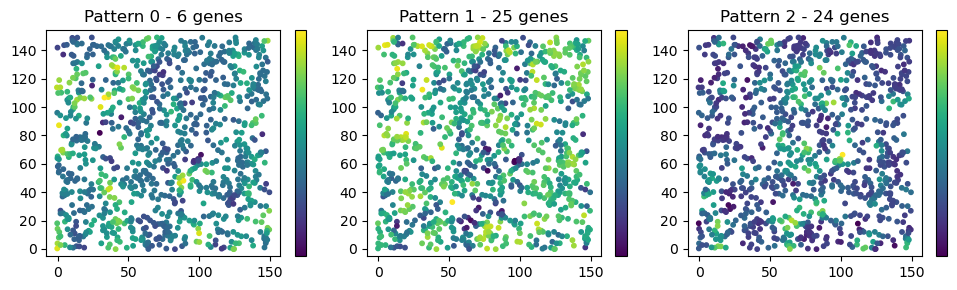

In [129]:
plt.figure(figsize=(10, 3))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.scatter(spatial_loc_sampled['x'], spatial_loc_sampled['y'], c=patterns.iloc[:, i], cmap='viridis', s=10)
    plt.axis('equal')

    n_genes = histology_results.query('pattern == @i').shape[0]
    plt.title(f'Pattern {i} - {n_genes} genes')
    plt.colorbar(ticks=[])

plt.tight_layout()
plt.show()

# Sim290

In [135]:
adata290 = ad.AnnData(omics290)
adata290.obs = meta290

cmat290 = pd.DataFrame(adata290.X, index=adata290.obs_names)
cmat290 = cmat290.transpose()

/Users/dongli/anaconda3/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [137]:
adata290.obsm["spatial"] = adata290.obs[["col", "row"]].to_numpy()

spatial_loc290 = pd.DataFrame(adata290.obsm['spatial'], columns=['x', 'y'], index=adata290.obs_names)
spatial_loc290 = spatial_loc290.loc[cmat290.columns,]
spatial_loc290['total_counts'] = cmat290.sum(axis=0)

spatial_loc290[['x', 'y']] = spatial_loc290[['x', 'y']].apply(pd.to_numeric, errors='coerce')
spatial_loc290['total_counts'] = pd.to_numeric(spatial_loc290['total_counts'], errors='coerce')
spatial_loc290['log_total_counts'] = np.log(spatial_loc290['total_counts'])

spatial_loc290['log_total_counts'] = pd.to_numeric(spatial_loc290['log_total_counts'], errors='coerce')

In [139]:
norm_expr = NaiveDE.stabilize(cmat290.T)
resid_expr = NaiveDE.regress_out(spatial_loc290, norm_expr.T, 'log_total_counts').T

In [141]:
result = SpatialDE.run(spatial_loc290[['x', 'y']].values, resid_expr)

Models:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:178: RuntimeWarning: divide by zero encountered in scalar divide
  s2_logdelta = 1. / (derivative(LL_obj, np.log(max_delta), n=2) ** 2)


  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:310: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  model_results = model_results[model_results.groupby(['g'])['max_ll'].transform(max) == model_results['max_ll']]


In [143]:
result.sort_values('qval').head(15)[['g', 'l', 'qval']]

,g,l,qval
85,150,5.158895,0.000000e+00
79,26,5.158895,0.000000e+00
80,55,5.158895,0.000000e+00
81,125,5.158895,0.000000e+00
82,132,5.158895,0.000000e+00
83,134,5.158895,0.000000e+00
84,149,5.158895,0.000000e+00
86,156,5.158895,0.000000e+00
90,218,5.158895,0.000000e+00
92,10,12.423382,2.422305e-15


In [145]:
top15_genes = result.sort_values("qval").head(15)["g"].tolist()

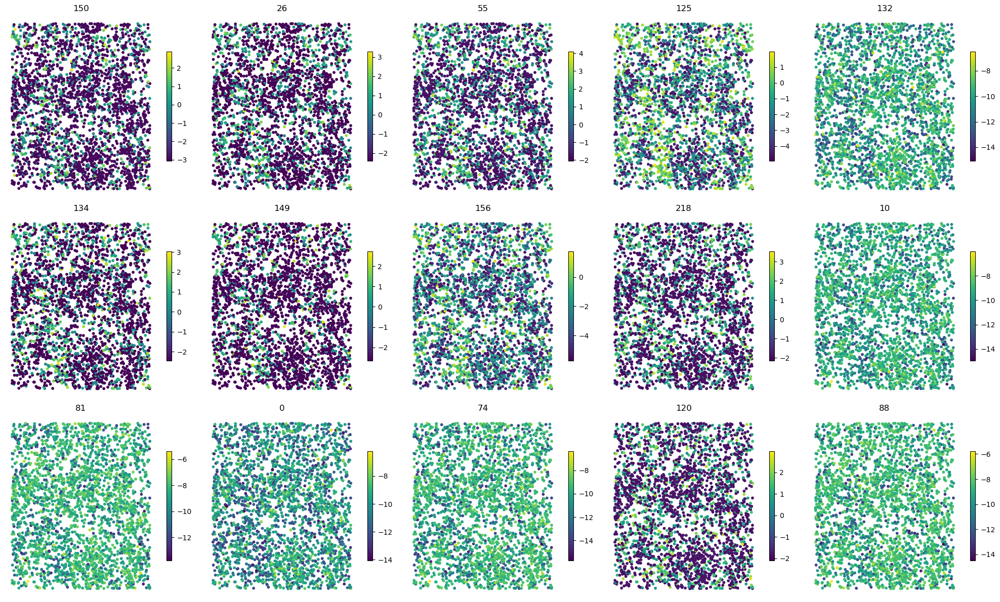

In [147]:
n_cols = 5
n_rows = (len(top15_genes) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows))
axes = axes.flatten()

resid_t = pd.DataFrame(resid_expr, index=cmat290.columns, columns=cmat290.index).T
for i, gene in enumerate(top15_genes):
    ax = axes[i]

    # extract spatial expression
    df = spatial_loc290.copy()
    df["expression"] = resid_t.loc[gene].values

    sc = ax.scatter(df["x"], df["y"], c=df["expression"], cmap="viridis", s=10)
    ax.set_title(gene)
    ax.axis("off")
    fig.colorbar(sc, ax=ax, shrink=0.6)

# remove empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### The fraction of variance explained by spatial variation

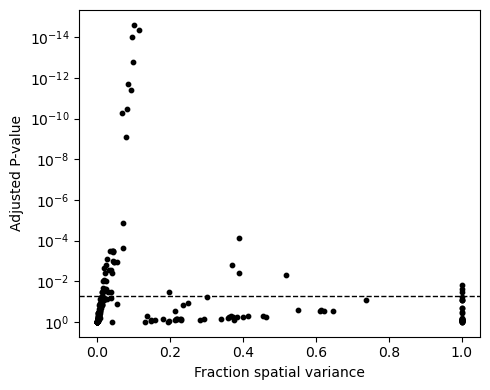

In [151]:
#plot
plt.figure(figsize=(5, 4))
plt.yscale('log')

# Scatter plot of FSV vs q-value
plt.scatter(result['FSV'], result['qval'], color='black', s=10)

# add significance threshold line at q = 0.05
plt.axhline(0.05, color='black', linewidth=1, linestyle='--')

plt.gca().invert_yaxis()
plt.xlabel('Fraction spatial variance')
plt.ylabel('Adjusted P-value')

plt.tight_layout()
plt.show()

## **Automatic expression histology**

In [155]:
sign_results = result.query('qval < 0.05')
sign_results['l'].value_counts()

l
29.917339    30
5.158895      9
12.423382     9
0.889591      4
0.369409      3
Name: count, dtype: int64

In [157]:
spatial_loc_sampled = spatial_loc290.sample(n=1000, random_state=42)

resid_expr_sampled = resid_expr.loc[spatial_loc_sampled.index].copy()

In [159]:
histology_results, patterns = SpatialDE.aeh.spatial_patterns(spatial_loc_sampled[['x', 'y']].values, resid_expr_sampled, sign_results, C=5, l=8.7, verbosity=2)

iter 0, ELBO: -6.51e+10

iter 1, ELBO: -3.23e+10, delta_ELBO: 3.29e+10
ln(l): 2.16, ln(s2e): 0.69

iter 2, ELBO: -3.23e+10, delta_ELBO: 7.30e+03
ln(l): 2.16, ln(s2e): -0.07

iter 3, ELBO: -3.23e+10, delta_ELBO: 2.88e+03
ln(l): 2.16, ln(s2e): -0.17

iter 4, ELBO: -3.23e+10, delta_ELBO: 1.50e+02
ln(l): 2.16, ln(s2e): -0.18

iter 5, ELBO: -3.23e+10, delta_ELBO: 3.13e+00
ln(l): 2.16, ln(s2e): -0.18

iter 6, ELBO: -3.23e+10, delta_ELBO: 6.41e-02
ln(l): 2.16, ln(s2e): -0.18

iter 7, ELBO: -3.23e+10, delta_ELBO: 7.82e-02
ln(l): 2.16, ln(s2e): -0.18

iter 8, ELBO: -3.23e+10, delta_ELBO: 7.55e-02
ln(l): 2.16, ln(s2e): -0.18

iter 9, ELBO: -3.23e+10, delta_ELBO: 1.52e-03
ln(l): 2.16, ln(s2e): -0.18

Converged on iter 9


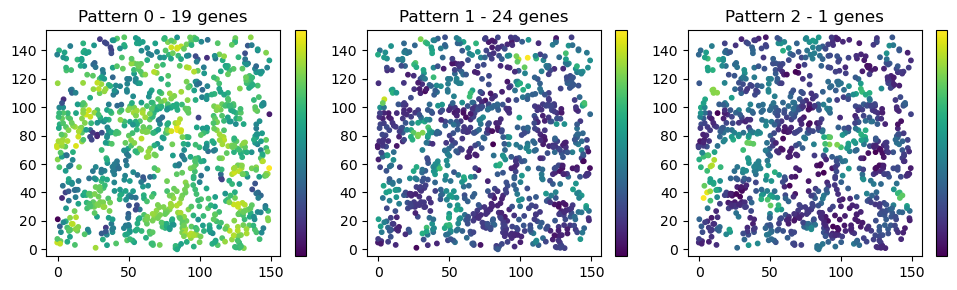

In [163]:
plt.figure(figsize=(10, 3))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.scatter(spatial_loc_sampled['x'], spatial_loc_sampled['y'], c=patterns.iloc[:, i], cmap='viridis', s=10)
    plt.axis('equal')

    n_genes = histology_results.query('pattern == @i').shape[0]
    plt.title(f'Pattern {i} - {n_genes} genes')
    plt.colorbar(ticks=[])

plt.tight_layout()
plt.show()

# Sim291

In [213]:
adata291 = ad.AnnData(omics291)
adata291.obs = meta291

/Users/dongli/anaconda3/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [215]:
cmat291 = pd.DataFrame(adata291.X, index=adata291.obs_names)
cmat291 = cmat291.transpose()

In [217]:
adata291.obsm["spatial"] = adata291.obs[["col", "row"]].to_numpy()

spatial_loc291 = pd.DataFrame(adata291.obsm['spatial'], columns=['x', 'y'], index=adata291.obs_names)
spatial_loc291 = spatial_loc291.loc[cmat291.columns,]
spatial_loc291['total_counts'] = cmat291.sum(axis=0)

spatial_loc291[['x', 'y']] = spatial_loc291[['x', 'y']].apply(pd.to_numeric, errors='coerce')
spatial_loc291['total_counts'] = pd.to_numeric(spatial_loc291['total_counts'], errors='coerce')
spatial_loc291['log_total_counts'] = np.log(spatial_loc291['total_counts'])

spatial_loc291['log_total_counts'] = pd.to_numeric(spatial_loc291['log_total_counts'], errors='coerce')

In [219]:
norm_expr = NaiveDE.stabilize(cmat291.T)
resid_expr = NaiveDE.regress_out(spatial_loc291, norm_expr.T, 'log_total_counts').T

In [221]:
result = SpatialDE.run(spatial_loc291[['x', 'y']].values, resid_expr)

Models:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:310: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  model_results = model_results[model_results.groupby(['g'])['max_ll'].transform(max) == model_results['max_ll']]


In [223]:
result.sort_values('qval').head(15)[['g', 'l', 'qval']]

,g,l,qval
109,38,9.759596,0.0
156,165,9.759596,0.0
151,156,9.759596,0.0
149,149,9.759596,0.0
144,135,9.759596,0.0
143,134,9.759596,0.0
142,131,9.759596,0.0
141,127,9.759596,0.0
140,125,9.759596,0.0
137,112,9.759596,0.0


In [225]:
top15_genes = result.sort_values("qval").head(15)["g"].tolist()

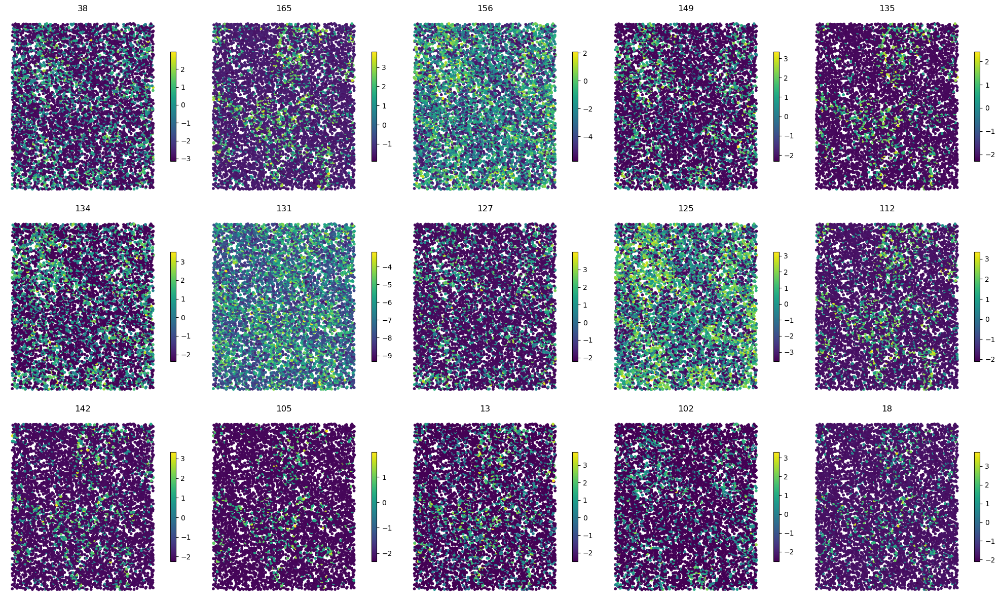

In [227]:
n_cols = 5
n_rows = (len(top15_genes) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows))
axes = axes.flatten()

resid_t = pd.DataFrame(resid_expr, index=cmat291.columns, columns=cmat291.index).T
for i, gene in enumerate(top15_genes):
    ax = axes[i]

    # extract spatial expression
    df = spatial_loc291.copy()
    df["expression"] = resid_t.loc[gene].values

    sc = ax.scatter(df["x"], df["y"], c=df["expression"], cmap="viridis", s=10)
    ax.set_title(gene)
    ax.axis("off")
    fig.colorbar(sc, ax=ax, shrink=0.6)

# remove empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## The fraction of variance explained by spatial variation

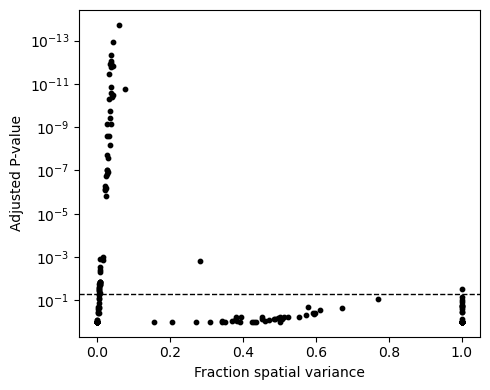

In [229]:
#plot
plt.figure(figsize=(5, 4))
plt.yscale('log')

# Scatter plot of FSV vs q-value
plt.scatter(result['FSV'], result['qval'], color='black', s=10)

# add significance threshold line at q = 0.05
plt.axhline(0.05, color='black', linewidth=1, linestyle='--')

plt.gca().invert_yaxis()
plt.xlabel('Fraction spatial variance')
plt.ylabel('Adjusted P-value')

plt.tight_layout()
plt.show()

## **Automatic expression histology**

In [231]:
sign_results = result.query('qval < 0.05')
sign_results['l'].value_counts()

l
9.759596     61
24.981092    21
0.227360      1
0.581960      1
3.812872      1
Name: count, dtype: int64

In [233]:
spatial_loc_sampled = spatial_loc291.sample(n=1000, random_state=42)

resid_expr_sampled = resid_expr.loc[spatial_loc_sampled.index].copy()

In [235]:
histology_results, patterns = SpatialDE.aeh.spatial_patterns(spatial_loc_sampled[['x', 'y']].values, resid_expr_sampled, sign_results, C=5, l=8.7, verbosity=2)

iter 0, ELBO: -4.57e+10

iter 1, ELBO: -2.35e+10, delta_ELBO: 2.22e+10
ln(l): 2.16, ln(s2e): 0.69

iter 2, ELBO: -2.35e+10, delta_ELBO: 1.34e+04
ln(l): 2.16, ln(s2e): -0.05

iter 3, ELBO: -2.35e+10, delta_ELBO: 5.24e+02
ln(l): 2.16, ln(s2e): -0.07

iter 4, ELBO: -2.35e+10, delta_ELBO: 5.40e+02
ln(l): 2.16, ln(s2e): -0.11

iter 5, ELBO: -2.35e+10, delta_ELBO: 1.45e+03
ln(l): 2.16, ln(s2e): -0.14

iter 6, ELBO: -2.35e+10, delta_ELBO: 1.31e+02
ln(l): 2.16, ln(s2e): -0.14

iter 7, ELBO: -2.35e+10, delta_ELBO: 2.49e+00
ln(l): 2.16, ln(s2e): -0.14

iter 8, ELBO: -2.35e+10, delta_ELBO: 3.45e-02
ln(l): 2.16, ln(s2e): -0.14

iter 9, ELBO: -2.35e+10, delta_ELBO: 5.00e-04
ln(l): 2.16, ln(s2e): -0.14

Converged on iter 9


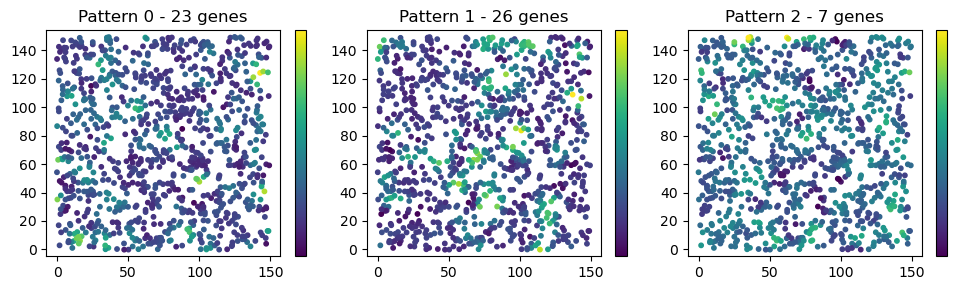

In [237]:
plt.figure(figsize=(10, 3))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.scatter(spatial_loc_sampled['x'], spatial_loc_sampled['y'], c=patterns.iloc[:, i], cmap='viridis', s=10)
    plt.axis('equal')

    n_genes = histology_results.query('pattern == @i').shape[0]
    plt.title(f'Pattern {i} - {n_genes} genes')
    plt.colorbar(ticks=[])

plt.tight_layout()
plt.show()

# Sim380

In [239]:
adata380 = ad.AnnData(omics380)
adata380.obs = meta380

/Users/dongli/anaconda3/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [241]:
cmat380 = pd.DataFrame(adata380.X, index=adata380.obs_names)
cmat380 = cmat380.transpose()

In [243]:
adata380.obsm["spatial"] = adata380.obs[["col", "row"]].to_numpy()

spatial_loc380 = pd.DataFrame(adata380.obsm['spatial'], columns=['x', 'y'], index=adata380.obs_names)
spatial_loc380 = spatial_loc380.loc[cmat380.columns,]
spatial_loc380['total_counts'] = cmat380.sum(axis=0)

spatial_loc380[['x', 'y']] = spatial_loc380[['x', 'y']].apply(pd.to_numeric, errors='coerce')
spatial_loc380['total_counts'] = pd.to_numeric(spatial_loc380['total_counts'], errors='coerce')
spatial_loc380['log_total_counts'] = np.log(spatial_loc380['total_counts'])

spatial_loc380['log_total_counts'] = pd.to_numeric(spatial_loc380['log_total_counts'], errors='coerce')

In [245]:
norm_expr = NaiveDE.stabilize(cmat380.T)
resid_expr = NaiveDE.regress_out(spatial_loc380, norm_expr.T, 'log_total_counts').T

In [247]:
result = SpatialDE.run(spatial_loc380[['x', 'y']].values, resid_expr)

Models:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:310: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  model_results = model_results[model_results.groupby(['g'])['max_ll'].transform(max) == model_results['max_ll']]


In [249]:
result.sort_values('qval').head(15)[['g', 'l', 'qval']]

,g,l,qval
158,83,8.613507,0.000000e+00
147,125,3.263257,0.000000e+00
148,132,3.263257,0.000000e+00
149,134,3.263257,0.000000e+00
150,149,3.263257,0.000000e+00
162,218,8.613507,0.000000e+00
151,150,3.263257,0.000000e+00
146,26,3.263257,0.000000e+00
152,156,3.263257,0.000000e+00
154,44,8.613507,0.000000e+00


In [251]:
top15_genes = result.sort_values("qval").head(15)["g"].tolist()

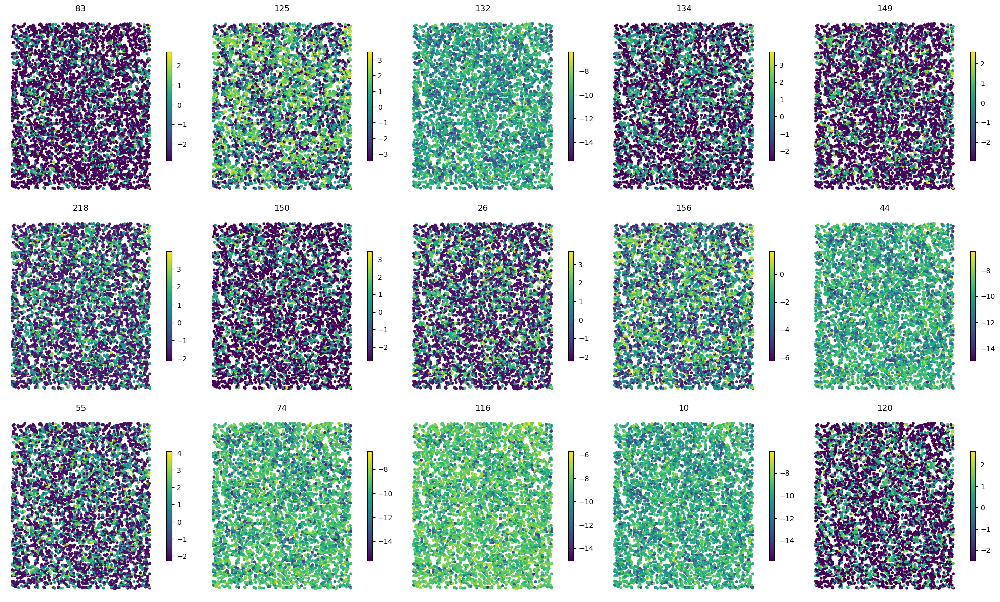

In [253]:
n_cols = 5
n_rows = (len(top15_genes) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows))
axes = axes.flatten()

resid_t = pd.DataFrame(resid_expr, index=cmat380.columns, columns=cmat380.index).T
for i, gene in enumerate(top15_genes):
    ax = axes[i]

    # extract spatial expression
    df = spatial_loc380.copy()
    df["expression"] = resid_t.loc[gene].values

    sc = ax.scatter(df["x"], df["y"], c=df["expression"], cmap="viridis", s=10)
    ax.set_title(gene)
    ax.axis("off")
    fig.colorbar(sc, ax=ax, shrink=0.6)

# remove empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## The fraction of variance explained by spatial variation

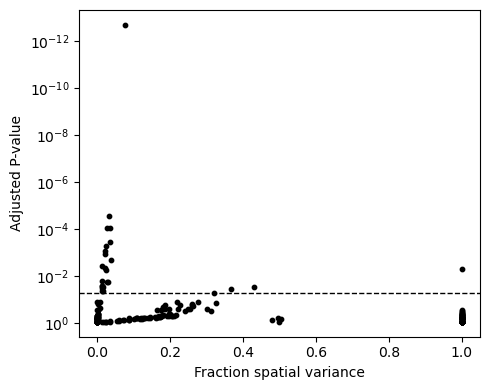

In [255]:
#plot
plt.figure(figsize=(5, 4))
plt.yscale('log')

# Scatter plot of FSV vs q-value
plt.scatter(result['FSV'], result['qval'], color='black', s=10)

# add significance threshold line at q = 0.05
plt.axhline(0.05, color='black', linewidth=1, linestyle='--')

plt.gca().invert_yaxis()
plt.xlabel('Fraction spatial variance')
plt.ylabel('Adjusted P-value')

plt.tight_layout()
plt.show()

## **Automatic expression histology**

In [257]:
sign_results = result.query('qval < 0.05')
sign_results['l'].value_counts()

l
22.735720    20
3.263257      7
8.613507      5
0.468375      2
0.177446      1
Name: count, dtype: int64

In [259]:
spatial_loc_sampled = spatial_loc380.sample(n=1000, random_state=42)

resid_expr_sampled = resid_expr.loc[spatial_loc_sampled.index].copy()

In [261]:
histology_results, patterns = SpatialDE.aeh.spatial_patterns(spatial_loc_sampled[['x', 'y']].values, resid_expr_sampled, sign_results, C=5, l=8.7, verbosity=2)

iter 0, ELBO: -5.05e+10

iter 1, ELBO: -2.44e+10, delta_ELBO: 2.60e+10
ln(l): 2.16, ln(s2e): 0.68

iter 2, ELBO: -2.44e+10, delta_ELBO: 5.11e+03
ln(l): 2.16, ln(s2e): -0.11

iter 3, ELBO: -2.44e+10, delta_ELBO: 1.76e+03
ln(l): 2.16, ln(s2e): -0.20

iter 4, ELBO: -2.44e+10, delta_ELBO: 1.65e+02
ln(l): 2.16, ln(s2e): -0.21

iter 5, ELBO: -2.44e+10, delta_ELBO: 4.56e+00
ln(l): 2.16, ln(s2e): -0.21

iter 6, ELBO: -2.44e+10, delta_ELBO: 1.26e-01
ln(l): 2.16, ln(s2e): -0.21

iter 7, ELBO: -2.44e+10, delta_ELBO: 3.35e-03
ln(l): 2.16, ln(s2e): -0.21

Converged on iter 7


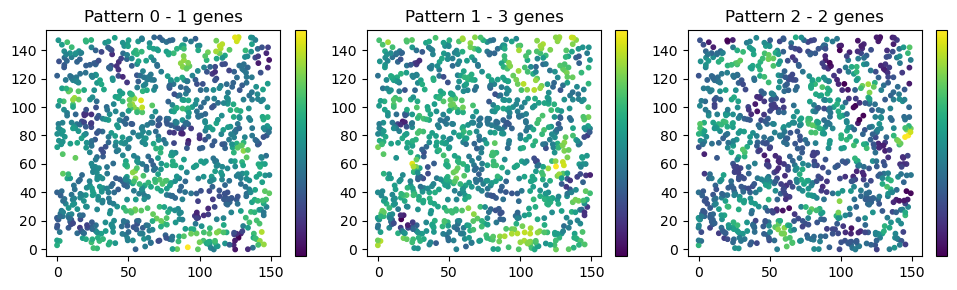

In [263]:
plt.figure(figsize=(10, 3))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.scatter(spatial_loc_sampled['x'], spatial_loc_sampled['y'], c=patterns.iloc[:, i], cmap='viridis', s=10)
    plt.axis('equal')

    n_genes = histology_results.query('pattern == @i').shape[0]
    plt.title(f'Pattern {i} - {n_genes} genes')
    plt.colorbar(ticks=[])

plt.tight_layout()
plt.show()

# Sim381

In [265]:
adata381 = ad.AnnData(omics381)
adata381.obs = meta381

/Users/dongli/anaconda3/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [267]:
cmat381 = pd.DataFrame(adata381.X, index=adata381.obs_names)
cmat381 = cmat381.transpose()

In [269]:
adata381.obsm["spatial"] = adata381.obs[["col", "row"]].to_numpy()

spatial_loc381 = pd.DataFrame(adata381.obsm['spatial'], columns=['x', 'y'], index=adata381.obs_names)
spatial_loc381 = spatial_loc381.loc[cmat381.columns,]
spatial_loc381['total_counts'] = cmat381.sum(axis=0)

spatial_loc381[['x', 'y']] = spatial_loc381[['x', 'y']].apply(pd.to_numeric, errors='coerce')
spatial_loc381['total_counts'] = pd.to_numeric(spatial_loc381['total_counts'], errors='coerce')
spatial_loc381['log_total_counts'] = np.log(spatial_loc381['total_counts'])

spatial_loc381['log_total_counts'] = pd.to_numeric(spatial_loc381['log_total_counts'], errors='coerce')

In [271]:
norm_expr = NaiveDE.stabilize(cmat381.T)
resid_expr = NaiveDE.regress_out(spatial_loc381, norm_expr.T, 'log_total_counts').T

In [273]:
result = SpatialDE.run(spatial_loc381[['x', 'y']].values, resid_expr)

Models:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:310: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  model_results = model_results[model_results.groupby(['g'])['max_ll'].transform(max) == model_results['max_ll']]


In [275]:
result.sort_values('qval').head(15)[['g', 'l', 'qval']]

,g,l,qval
134,27,11.052767,2.820588e-10
179,94,27.380138,1.539776e-04
160,35,27.380138,1.282948e-03
198,161,27.380138,1.311167e-03
167,58,27.380138,1.886330e-03
161,36,27.380138,6.898218e-03
182,104,27.380138,7.996406e-03
158,33,27.380138,1.014515e-02
52,6,0.293503,1.540466e-02
156,29,27.380138,2.766923e-02


In [277]:
top15_genes = result.sort_values("qval").head(15)["g"].tolist()

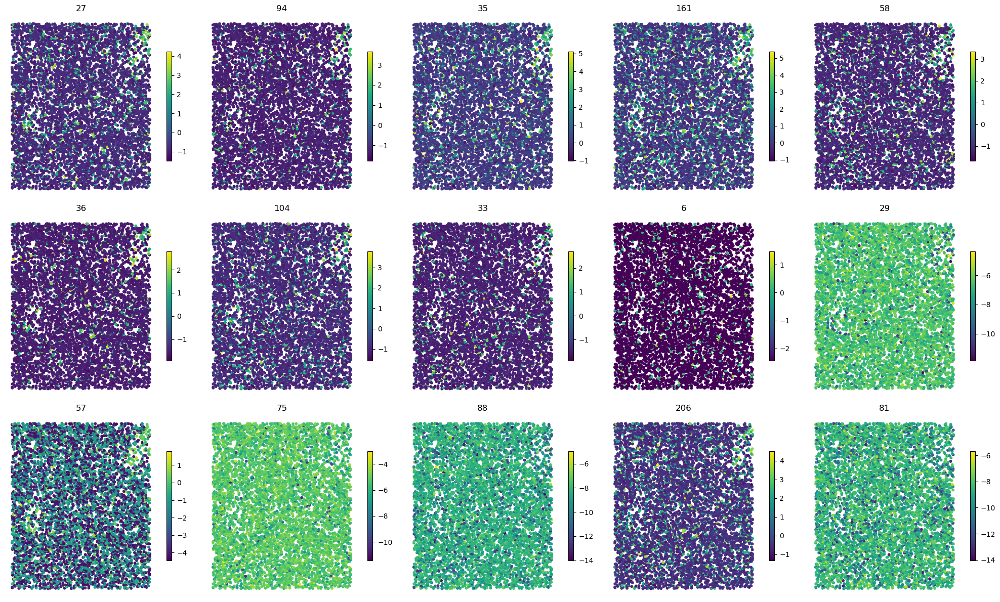

In [279]:
n_cols = 5
n_rows = (len(top15_genes) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows))
axes = axes.flatten()

resid_t = pd.DataFrame(resid_expr, index=cmat381.columns, columns=cmat381.index).T
for i, gene in enumerate(top15_genes):
    ax = axes[i]

    # extract spatial expression
    df = spatial_loc381.copy()
    df["expression"] = resid_t.loc[gene].values

    sc = ax.scatter(df["x"], df["y"], c=df["expression"], cmap="viridis", s=10)
    ax.set_title(gene)
    ax.axis("off")
    fig.colorbar(sc, ax=ax, shrink=0.6)

# remove empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## The fraction of variance explained by spatial variation

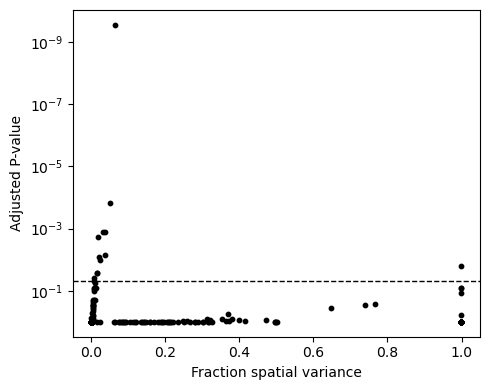

In [281]:
#plot
plt.figure(figsize=(5, 4))
plt.yscale('log')

# Scatter plot of FSV vs q-value
plt.scatter(result['FSV'], result['qval'], color='black', s=10)

# add significance threshold line at q = 0.05
plt.axhline(0.05, color='black', linewidth=1, linestyle='--')

plt.gca().invert_yaxis()
plt.xlabel('Fraction spatial variance')
plt.ylabel('Adjusted P-value')

plt.tight_layout()
plt.show()

## **Automatic expression histology**

In [283]:
sign_results = result.query('qval < 0.05')
sign_results['l'].value_counts()

l
27.380138    11
0.293503      1
11.052767     1
Name: count, dtype: int64

In [285]:
spatial_loc_sampled = spatial_loc381.sample(n=1000, random_state=42)

resid_expr_sampled = resid_expr.loc[spatial_loc_sampled.index].copy()

In [287]:
histology_results, patterns = SpatialDE.aeh.spatial_patterns(spatial_loc_sampled[['x', 'y']].values, resid_expr_sampled, sign_results, C=5, l=8.7, verbosity=2)

iter 0, ELBO: -5.12e+10

iter 1, ELBO: -2.55e+10, delta_ELBO: 2.57e+10
ln(l): 2.16, ln(s2e): 0.70

iter 2, ELBO: -2.55e+10, delta_ELBO: 2.08e+03
ln(l): 2.16, ln(s2e): -0.09

iter 3, ELBO: -2.55e+10, delta_ELBO: 3.15e+02
ln(l): 2.16, ln(s2e): -0.14

iter 4, ELBO: -2.55e+10, delta_ELBO: 6.79e+01
ln(l): 2.16, ln(s2e): -0.15

iter 5, ELBO: -2.55e+10, delta_ELBO: 1.78e+00
ln(l): 2.16, ln(s2e): -0.15

iter 6, ELBO: -2.55e+10, delta_ELBO: 4.66e-02
ln(l): 2.16, ln(s2e): -0.15

iter 7, ELBO: -2.55e+10, delta_ELBO: 1.17e-03
ln(l): 2.16, ln(s2e): -0.15

Converged on iter 7


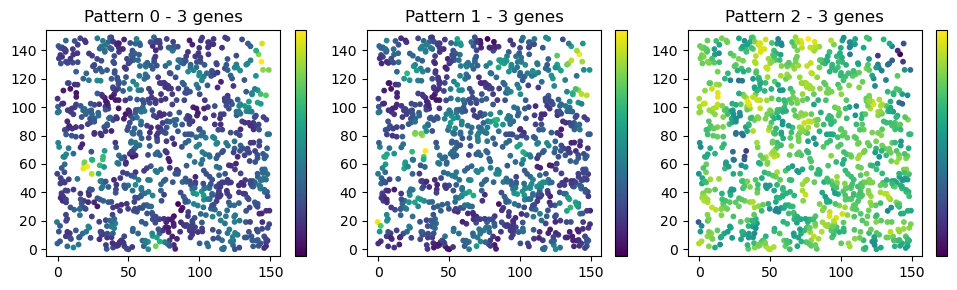

In [289]:
plt.figure(figsize=(10, 3))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.scatter(spatial_loc_sampled['x'], spatial_loc_sampled['y'], c=patterns.iloc[:, i], cmap='viridis', s=10)
    plt.axis('equal')

    n_genes = histology_results.query('pattern == @i').shape[0]
    plt.title(f'Pattern {i} - {n_genes} genes')
    plt.colorbar(ticks=[])

plt.tight_layout()
plt.show()

# Sim390

In [291]:
adata390 = ad.AnnData(omics390)
adata390.obs = meta390

/Users/dongli/anaconda3/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [293]:
cmat390 = pd.DataFrame(adata390.X, index=adata390.obs_names)
cmat390 = cmat390.transpose()

In [295]:
adata390.obsm["spatial"] = adata390.obs[["col", "row"]].to_numpy()

spatial_loc390 = pd.DataFrame(adata390.obsm['spatial'], columns=['x', 'y'], index=adata390.obs_names)
spatial_loc390 = spatial_loc390.loc[cmat390.columns,]
spatial_loc390['total_counts'] = cmat390.sum(axis=0)

spatial_loc390[['x', 'y']] = spatial_loc390[['x', 'y']].apply(pd.to_numeric, errors='coerce')
spatial_loc390['total_counts'] = pd.to_numeric(spatial_loc390['total_counts'], errors='coerce')
spatial_loc390['log_total_counts'] = np.log(spatial_loc390['total_counts'])

spatial_loc390['log_total_counts'] = pd.to_numeric(spatial_loc390['log_total_counts'], errors='coerce')

In [297]:
norm_expr = NaiveDE.stabilize(cmat390.T)
resid_expr = NaiveDE.regress_out(spatial_loc390, norm_expr.T, 'log_total_counts').T

In [299]:
result = SpatialDE.run(spatial_loc390[['x', 'y']].values, resid_expr)

Models:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:310: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  model_results = model_results[model_results.groupby(['g'])['max_ll'].transform(max) == model_results['max_ll']]


In [301]:
result.sort_values('qval').head(15)[['g', 'l', 'qval']]

,g,l,qval
0,1,0.056048,0.995189
140,46,0.407014,0.995189
141,55,0.407014,0.995189
142,57,0.407014,0.995189
143,61,0.407014,0.995189
144,62,0.407014,0.995189
145,64,0.407014,0.995189
146,72,0.407014,0.995189
147,81,0.407014,0.995189
148,83,0.407014,0.995189


In [303]:
top15_genes = result.sort_values("qval").head(15)["g"].tolist()

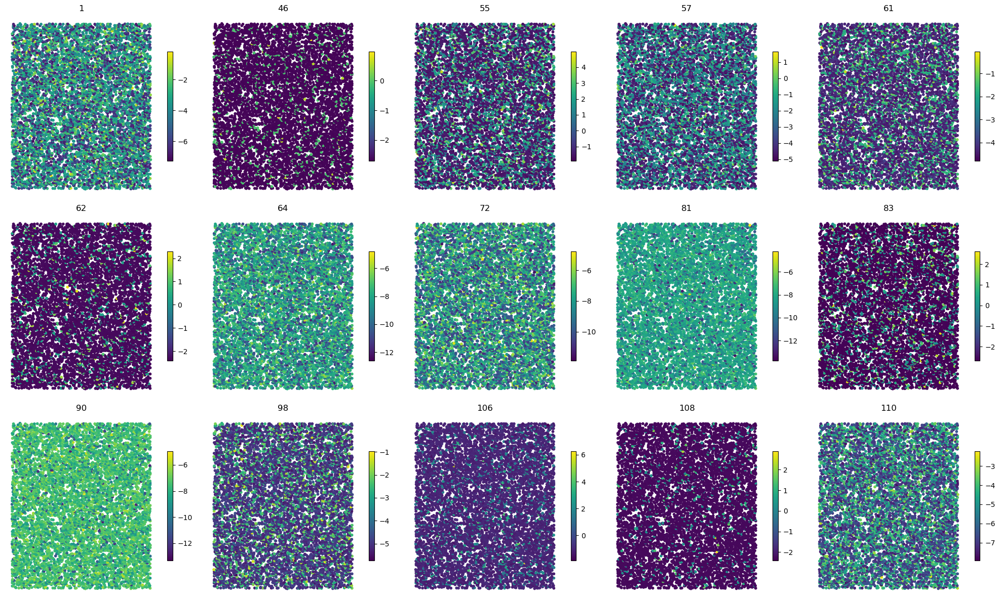

In [305]:
n_cols = 5
n_rows = (len(top15_genes) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows))
axes = axes.flatten()

resid_t = pd.DataFrame(resid_expr, index=cmat390.columns, columns=cmat390.index).T
for i, gene in enumerate(top15_genes):
    ax = axes[i]

    # extract spatial expression
    df = spatial_loc390.copy()
    df["expression"] = resid_t.loc[gene].values

    sc = ax.scatter(df["x"], df["y"], c=df["expression"], cmap="viridis", s=10)
    ax.set_title(gene)
    ax.axis("off")
    fig.colorbar(sc, ax=ax, shrink=0.6)

# remove empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## The fraction of variance explained by spatial variation

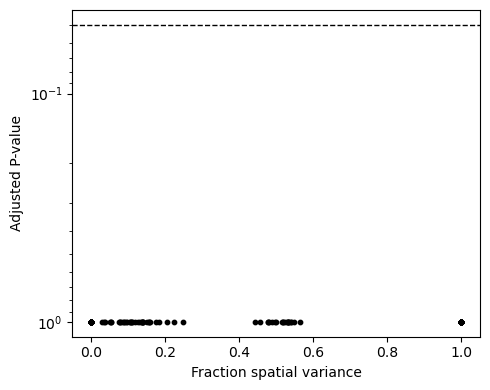

In [307]:
#plot
plt.figure(figsize=(5, 4))
plt.yscale('log')

# Scatter plot of FSV vs q-value
plt.scatter(result['FSV'], result['qval'], color='black', s=10)

# add significance threshold line at q = 0.05
plt.axhline(0.05, color='black', linewidth=1, linestyle='--')

plt.gca().invert_yaxis()
plt.xlabel('Fraction spatial variance')
plt.ylabel('Adjusted P-value')

plt.tight_layout()
plt.show()

## **Automatic expression histology**

In [309]:
sign_results = result.query('qval < 0.05')
sign_results['l'].value_counts()

Series([], Name: count, dtype: int64)

In [311]:
spatial_loc_sampled = spatial_loc390.sample(n=1000, random_state=42)

resid_expr_sampled = resid_expr.loc[spatial_loc_sampled.index].copy()

In [313]:
histology_results, patterns = SpatialDE.aeh.spatial_patterns(spatial_loc_sampled[['x', 'y']].values, resid_expr_sampled, sign_results, C=5, l=8.7, verbosity=2)

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/aeh.py:171: RuntimeWarning: invalid value encountered in divide
  pi = r.sum(0) / G


iter 0, ELBO: -4.73e+10



/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/aeh.py:195: RuntimeWarning: invalid value encountered in divide
  pi = r.sum(0) / G


iter 1, ELBO: -2.33e+10, delta_ELBO: 2.41e+10
ln(l): 2.16, ln(s2e): 0.00

iter 2, ELBO: -2.33e+10, delta_ELBO: 0.00e+00
ln(l): 2.16, ln(s2e): 0.00

Converged on iter 2


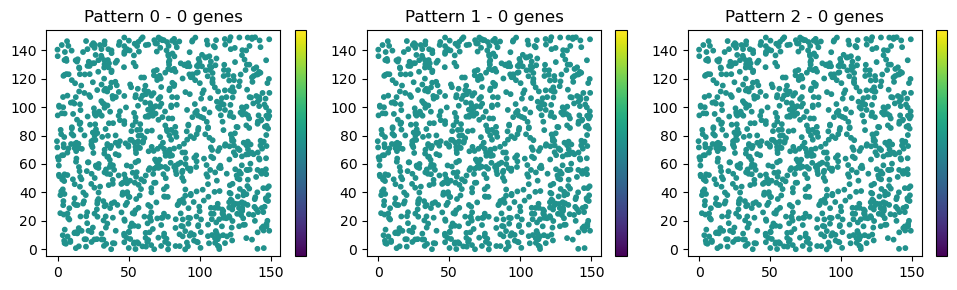

In [315]:
plt.figure(figsize=(10, 3))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.scatter(spatial_loc_sampled['x'], spatial_loc_sampled['y'], c=patterns.iloc[:, i], cmap='viridis', s=10)
    plt.axis('equal')

    n_genes = histology_results.query('pattern == @i').shape[0]
    plt.title(f'Pattern {i} - {n_genes} genes')
    plt.colorbar(ticks=[])

plt.tight_layout()
plt.show()

# Sim391

In [317]:
adata391 = ad.AnnData(omics391)
adata391.obs = meta391

/Users/dongli/anaconda3/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [319]:
cmat391 = pd.DataFrame(adata391.X, index=adata391.obs_names)
cmat391 = cmat391.transpose()

In [321]:
adata391.obsm["spatial"] = adata391.obs[["col", "row"]].to_numpy()

spatial_loc391 = pd.DataFrame(adata391.obsm['spatial'], columns=['x', 'y'], index=adata391.obs_names)
spatial_loc391 = spatial_loc391.loc[cmat391.columns,]
spatial_loc391['total_counts'] = cmat391.sum(axis=0)

spatial_loc391[['x', 'y']] = spatial_loc391[['x', 'y']].apply(pd.to_numeric, errors='coerce')
spatial_loc391['total_counts'] = pd.to_numeric(spatial_loc391['total_counts'], errors='coerce')
spatial_loc391['log_total_counts'] = np.log(spatial_loc391['total_counts'])

spatial_loc391['log_total_counts'] = pd.to_numeric(spatial_loc391['log_total_counts'], errors='coerce')

In [323]:
norm_expr = NaiveDE.stabilize(cmat391.T)
resid_expr = NaiveDE.regress_out(spatial_loc391, norm_expr.T, 'log_total_counts').T

In [325]:
result = SpatialDE.run(spatial_loc391[['x', 'y']].values, resid_expr)

Models:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:178: RuntimeWarning: divide by zero encountered in scalar divide
  s2_logdelta = 1. / (derivative(LL_obj, np.log(max_delta), n=2) ** 2)


  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

  0%|          | 0/220 [00:00<?, ?it/s]

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/base.py:310: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  model_results = model_results[model_results.groupby(['g'])['max_ll'].transform(max) == model_results['max_ll']]


In [327]:
result.sort_values('qval').head(15)[['g', 'l', 'qval']]

,g,l,qval
60,7,0.358074,0.790309
62,11,0.358074,0.949182
90,86,0.358074,0.949182
0,0,0.148107,0.992284
141,165,2.093004,0.992284
142,190,2.093004,0.992284
143,193,2.093004,0.992284
144,197,2.093004,0.992284
145,201,2.093004,0.992284
146,217,2.093004,0.992284


In [329]:
top15_genes = result.sort_values("qval").head(15)["g"].tolist()

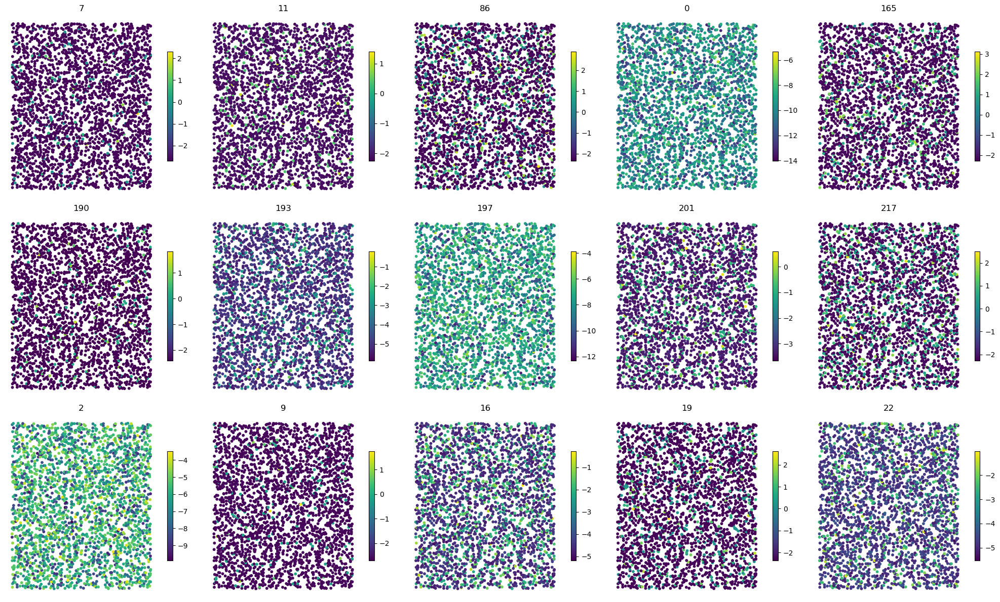

In [331]:
n_cols = 5
n_rows = (len(top15_genes) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows))
axes = axes.flatten()

resid_t = pd.DataFrame(resid_expr, index=cmat391.columns, columns=cmat391.index).T
for i, gene in enumerate(top15_genes):
    ax = axes[i]

    # extract spatial expression
    df = spatial_loc391.copy()
    df["expression"] = resid_t.loc[gene].values

    sc = ax.scatter(df["x"], df["y"], c=df["expression"], cmap="viridis", s=10)
    ax.set_title(gene)
    ax.axis("off")
    fig.colorbar(sc, ax=ax, shrink=0.6)

# remove empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## The fraction of variance explained by spatial variation

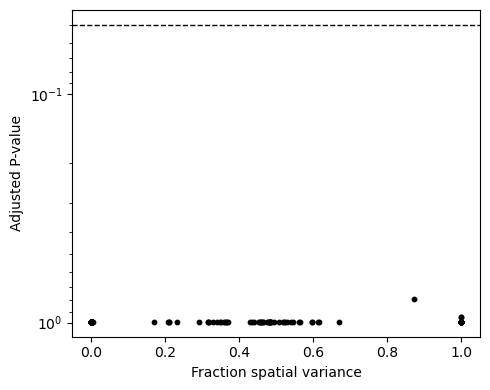

In [333]:
#plot
plt.figure(figsize=(5, 4))
plt.yscale('log')

# Scatter plot of FSV vs q-value
plt.scatter(result['FSV'], result['qval'], color='black', s=10)

# add significance threshold line at q = 0.05
plt.axhline(0.05, color='black', linewidth=1, linestyle='--')

plt.gca().invert_yaxis()
plt.xlabel('Fraction spatial variance')
plt.ylabel('Adjusted P-value')

plt.tight_layout()
plt.show()

## **Automatic expression histology**

In [335]:
sign_results = result.query('qval < 0.05')
sign_results['l'].value_counts()

Series([], Name: count, dtype: int64)

In [337]:
spatial_loc_sampled = spatial_loc391.sample(n=1000, random_state=42)

resid_expr_sampled = resid_expr.loc[spatial_loc_sampled.index].copy()

In [339]:
histology_results, patterns = SpatialDE.aeh.spatial_patterns(spatial_loc_sampled[['x', 'y']].values, resid_expr_sampled, sign_results, C=5, l=8.7, verbosity=2)

/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/aeh.py:171: RuntimeWarning: invalid value encountered in divide
  pi = r.sum(0) / G


iter 0, ELBO: -4.55e+10



/Users/dongli/anaconda3/lib/python3.11/site-packages/SpatialDE/aeh.py:195: RuntimeWarning: invalid value encountered in divide
  pi = r.sum(0) / G


iter 1, ELBO: -2.31e+10, delta_ELBO: 2.24e+10
ln(l): 2.16, ln(s2e): 0.00

iter 2, ELBO: -2.31e+10, delta_ELBO: 0.00e+00
ln(l): 2.16, ln(s2e): 0.00

Converged on iter 2


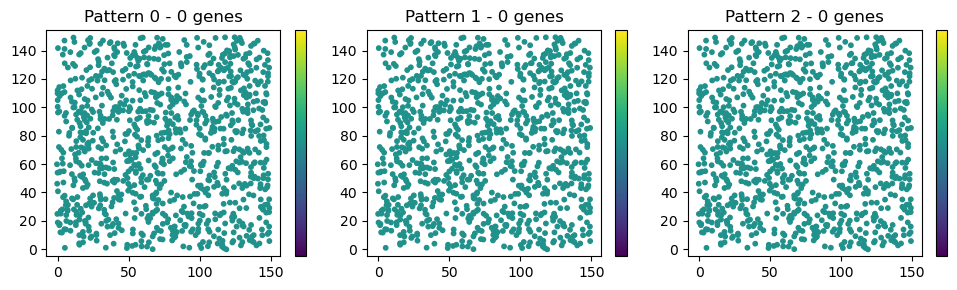

In [341]:
plt.figure(figsize=(10, 3))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.scatter(spatial_loc_sampled['x'], spatial_loc_sampled['y'], c=patterns.iloc[:, i], cmap='viridis', s=10)
    plt.axis('equal')

    n_genes = histology_results.query('pattern == @i').shape[0]
    plt.title(f'Pattern {i} - {n_genes} genes')
    plt.colorbar(ticks=[])

plt.tight_layout()
plt.show()